Installing libraries

In [1]:
!pip install diffusers==0.11.1
!pip install transformers scipy ftfy accelerate

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 9.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 18.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.3/215.3 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 36.6 MB/s eta 0:00:00


In [2]:
!nvidia-smi

Sun May  7 16:38:19 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
import torch
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel, StableDiffusionPipeline, PNDMScheduler, LMSDiscreteScheduler, KDPM2DiscreteScheduler, DPMSolverMultistepScheduler
from tqdm.auto import tqdm
from torch import autocast
from PIL import Image
import numpy as np

In [4]:
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5")

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [5]:
pipe.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.11.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "trained_betas": null
}

In [6]:
pipe.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('steps_offset', 1),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.11.1'),
            ('clip_sample', False)])

In [7]:
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

In [8]:
pipe.scheduler

DPMSolverMultistepScheduler {
  "_class_name": "DPMSolverMultistepScheduler",
  "_diffusers_version": "0.11.1",
  "algorithm_type": "dpmsolver++",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "dynamic_thresholding_ratio": 0.995,
  "lower_order_final": true,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "solver_order": 2,
  "solver_type": "midpoint",
  "steps_offset": 1,
  "thresholding": false,
  "trained_betas": null
}

In [9]:
def dummy(images, **kwargs):
    return images, False

In [10]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [11]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy

## Tests for final report

## guidance scale

  0%|          | 0/50 [00:00<?, ?it/s]

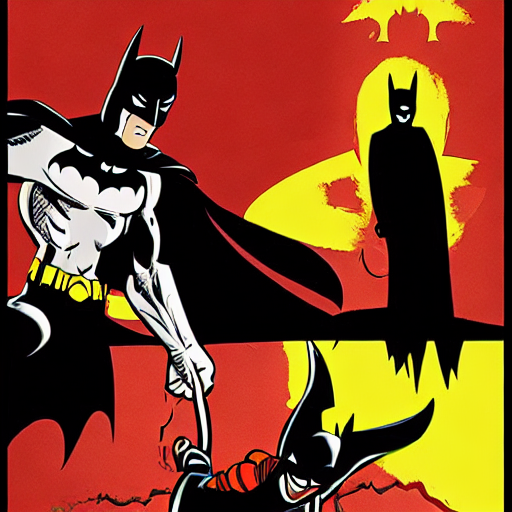

In [ ]:
prompt = 'an animation style movie poster of the batman'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

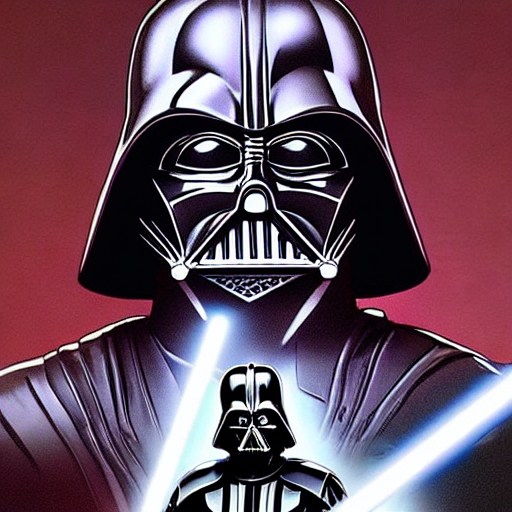

In [ ]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            negative_prompt='text on the movie poster',
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

In [ ]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [23]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(1)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [24]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

In [14]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(2)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [16]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

In [21]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(3)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [22]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

In [25]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(4)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [26]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

In [27]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(5)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [28]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

In [29]:
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
ws = [0, 2, 7.5, 15, 30, 50]
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for w in ws:
  generator = torch.Generator(torch_device).manual_seed(6)
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [30]:
image_grid(images, rows=1, cols=6)

Output hidden; open in https://colab.research.google.com to view.

  0%|          | 0/50 [00:00<?, ?it/s]

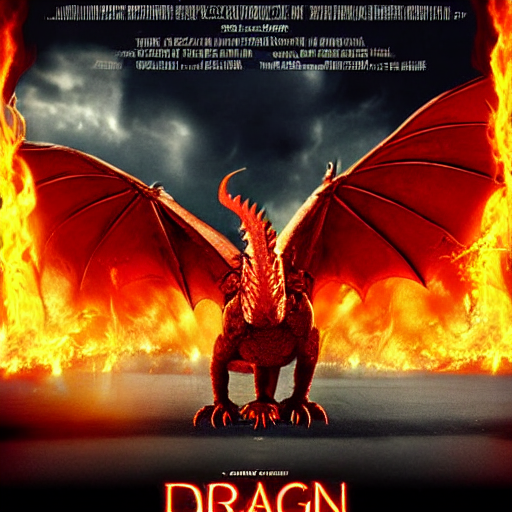

In [ ]:
prompt = 'A movie poster of the great red dragon with flames on the background'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

In [ ]:
prompt = 'a movie poster about the chinese dragon attacking a village, flames in the background'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

### blue shrek

In [ ]:
prompt = 'a movie poster of a blue Shrek'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
prompt = 'a movie poster of a blue Shrek'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              negative_prompt = 'text on the movie poster',
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
prompt = 'a movie poster of Shrek'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
prompt = 'a movie poster of Shrek'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              negative_prompt='text on the movie poster',
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
prompt = 'a movie poster of Shrek, but all the characters are blue'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
prompt = 'a movie poster of Shrek, but all the characters are blue'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images = []

for i in range(5):
  image = pipe(prompt,
              negative_prompt='text on the movie poster', 
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
image_grid(images, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

## Old tests

  0%|          | 0/50 [00:00<?, ?it/s]

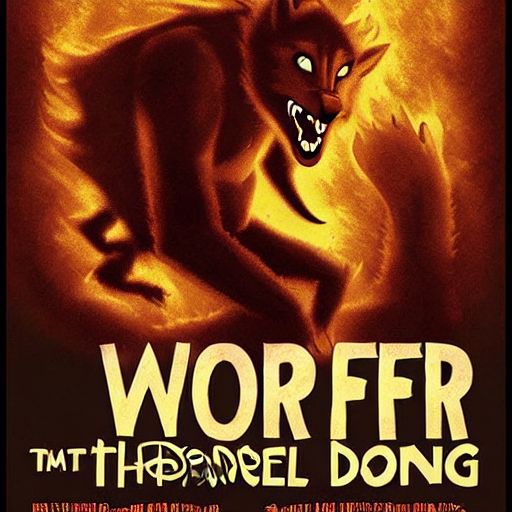

In [ ]:
prompt = 'a movie poster about a werewolf trying to destroy the world in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

## Testing different image sizes

CELL above sometimes won't run given the ammount of memory necessary to generate an image of this size.

In [ ]:
prompt = 'a movie poster about a werewolf trying to destroy the world in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 1024
width = 512
images_large_h = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images_large_h.append(image)

In [ ]:
prompt = 'a movie poster about a werewolf trying to destroy the world in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 768
width = 512
images_medium_h = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images_medium_h.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
prompt = 'a movie poster about a werewolf trying to destroy the world in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512
images_small_h = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images_small_h.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

### 1024 x 512

In [ ]:
image_grid(images_large_h, rows=1, cols=5)

### 768 x 512

In [ ]:
image_grid(images_medium_h, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

### 512 x 512

In [ ]:
image_grid(images_small_h, rows=1, cols=5)

Output hidden; open in https://colab.research.google.com to view.

From this we say we decided to go with 512x512

## Testing number of diffusion steps

In [ ]:
prompt

'a movie poster with a dragon attacking a village, chinese paiting style'

  0%|          | 0/50 [00:00<?, ?it/s]

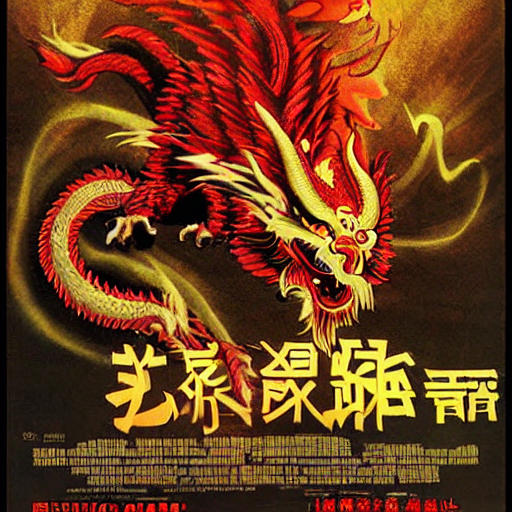

In [ ]:
#prompt = 'a movie poster with peasants fighting to survive the chinese dragon attack'
prompt = 'a movie poster with the chinese dragon attacking a village'
#prompt = 'a movie poster with a dragon attacking a village, chinese paiting style'
#prompt = 'a movie poster about a dragon trying to destroy the world'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

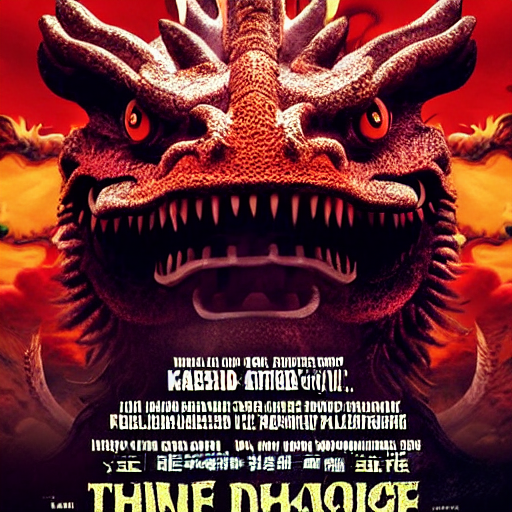

In [ ]:
prompt = 'a movie poster with the chinese dragon attacking a village'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

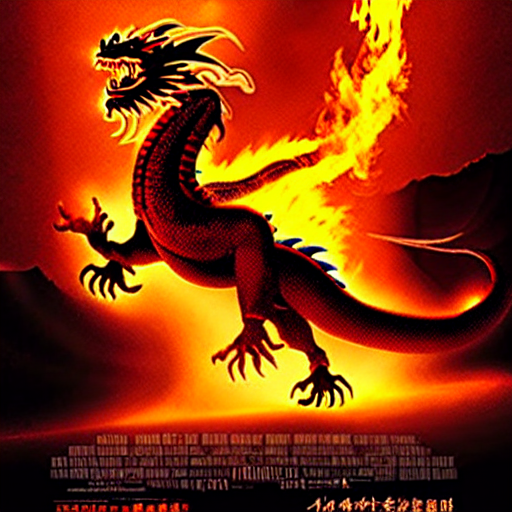

In [ ]:
prompt = 'a movie poster with the chinese dragon attacking a village, houses in flame in the background'
generator = torch.Generator(torch_device).manual_seed(1)
w = 20 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/100 [00:00<?, ?it/s]

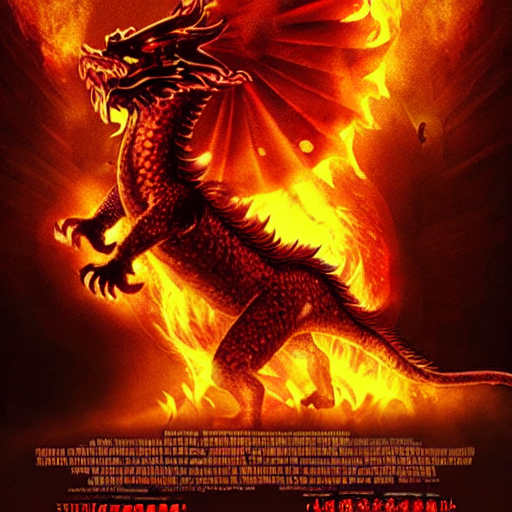

In [ ]:
prompt = 'a movie poster about the chinese dragon attacking a village, flames in the background'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 100
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

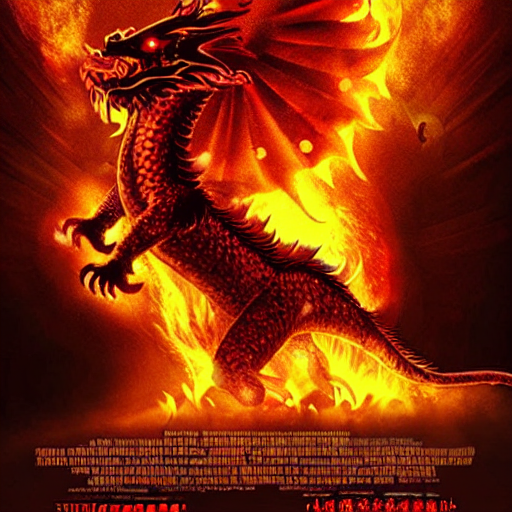

In [ ]:
prompt = 'a movie poster about the chinese dragon attacking a village, flames in the background'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

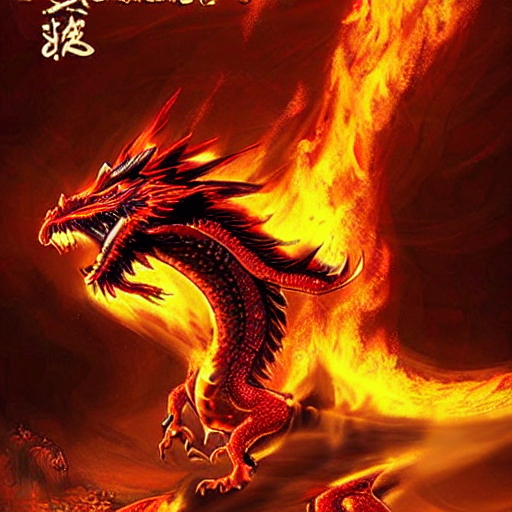

In [ ]:
prompt = 'a movie poster about the chinese dragon attacking a village, flames in the background'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            negative_prompt='text on the movie poster',
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

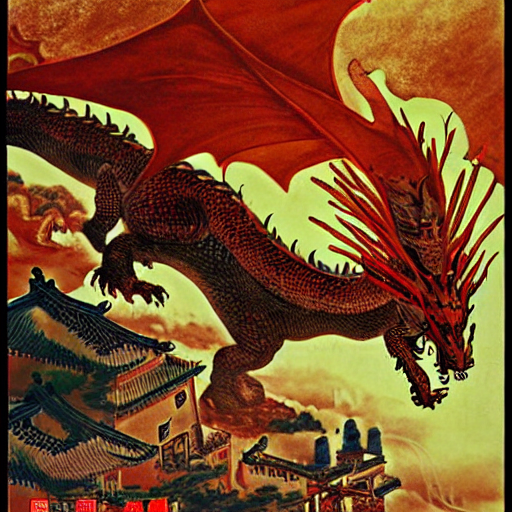

In [ ]:
#prompt = 'a movie poster with peasants fighting to survive the chinese dragon attack'
#prompt = 'a movie poster with the chinese dragon attacking a village chinese paiting style'
prompt = 'a movie poster with a dragon attacking a village, chinese paiting style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

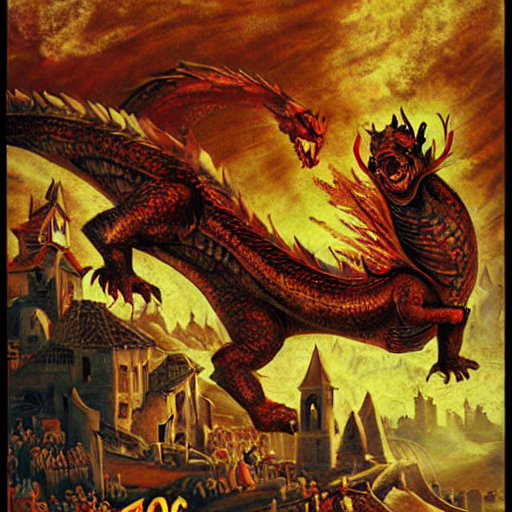

In [ ]:
#prompt = 'a movie poster with peasants fighting to survive the chinese dragon attack'
#prompt = 'a movie poster with the chinese dragon attacking a village chinese paiting style'
prompt = 'a movie poster with a dragon attacking a village, baroque paiting style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
            generator=generator,
            guidance_scale=w,
            height=height,
            width=width,
            num_inference_steps=num_inference_steps,
            num_images_per_prompt=n_images).images[0]
image

In [ ]:
prompt = 'a movie poster about a werewolf trying to destroy the world in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #7.5
num_inference_steps = [25, 50, 75, 100, 200]
n_images = 1

height = 512
width = 512
images_small_h = []

for i in range(5):
  image = pipe(prompt,
              generator=generator,
              guidance_scale=w,
              height=height,
              width=width,
              num_inference_steps=num_inference_steps,
              num_images_per_prompt=n_images).images[0]
  images_small_h.append(image)

  0%|          | 0/50 [00:00<?, ?it/s]

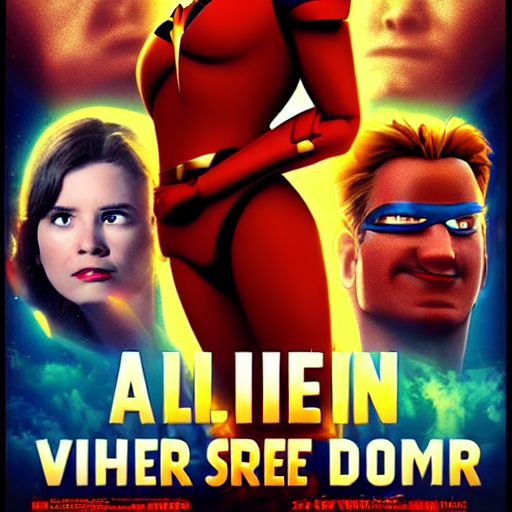

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 15 #7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

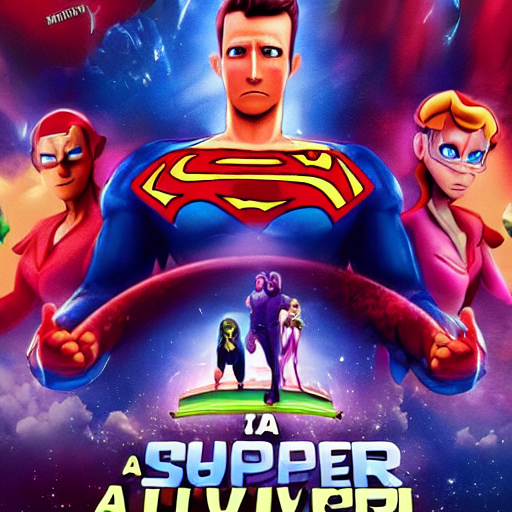

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in disney style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

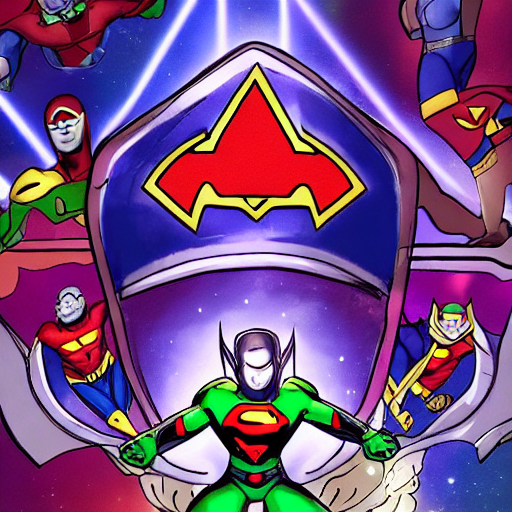

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in disney style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

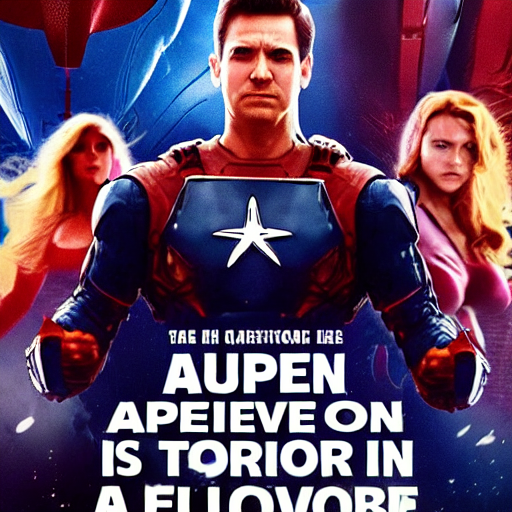

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in dc studios style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

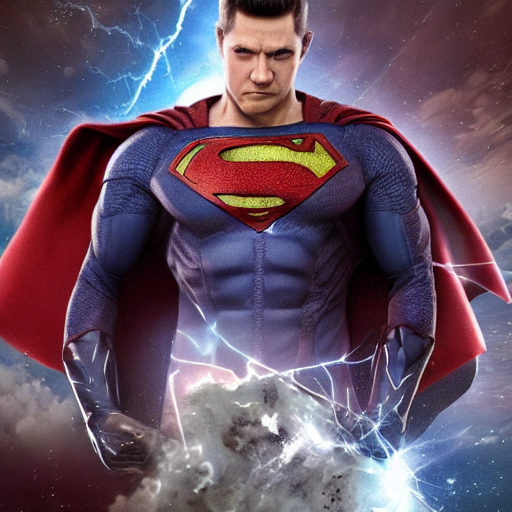

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in dc studios style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

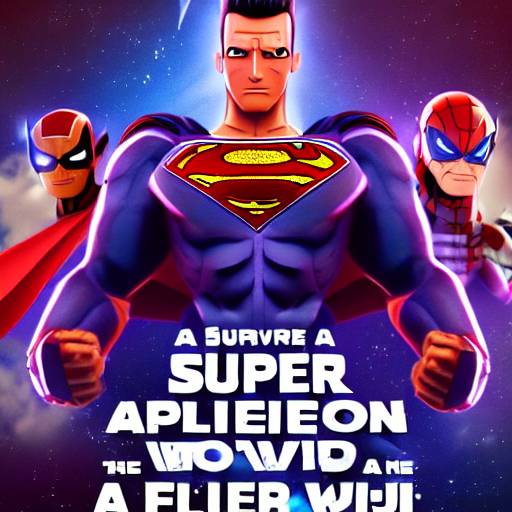

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in dc studios animation style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

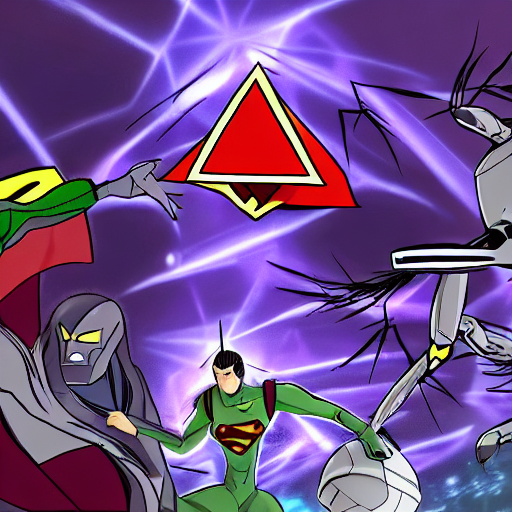

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster about a super hero trying to save the world from an alien invasion in dc studios animation style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

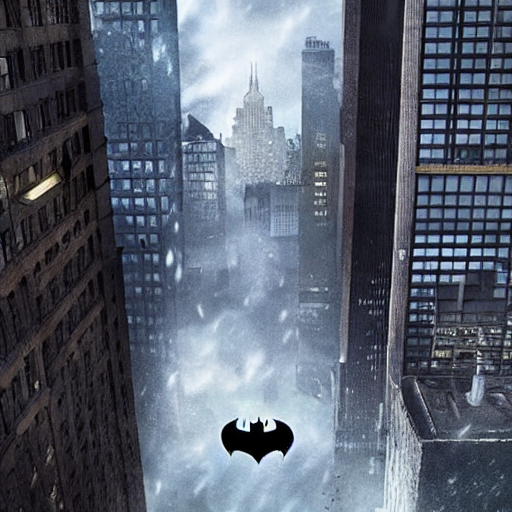

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a movie poster of batman watching over gotham'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

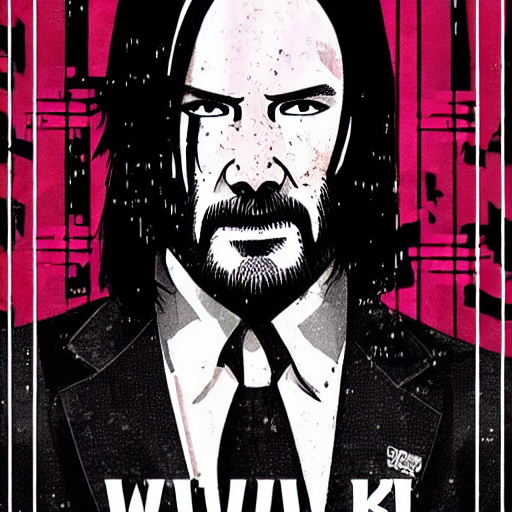

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a manga style movie poster of John Wick'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

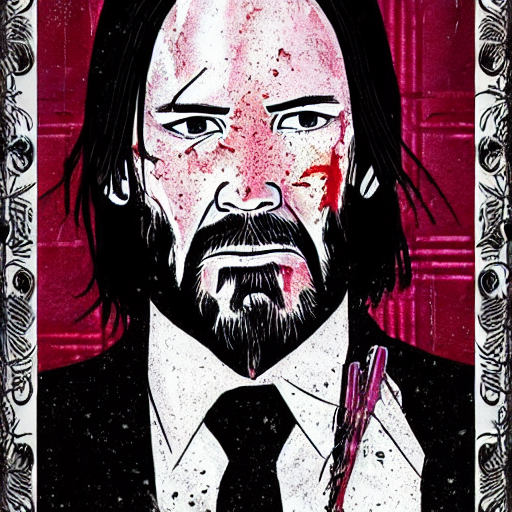

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a manga style movie poster of John Wick'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

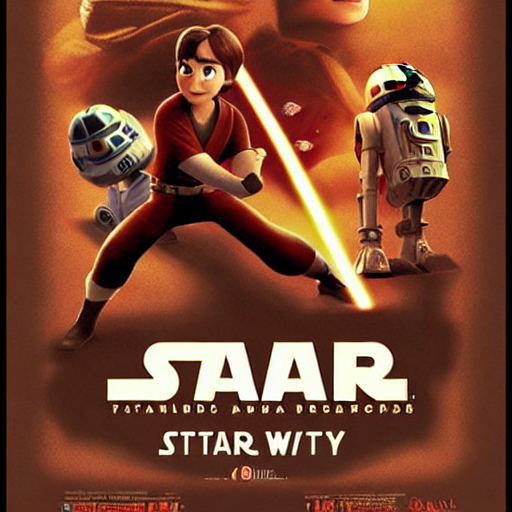

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style movie poster of Star Wars'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

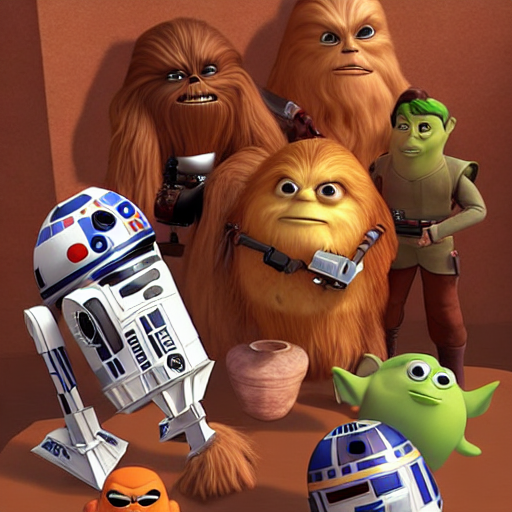

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style movie poster of Star Wars'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

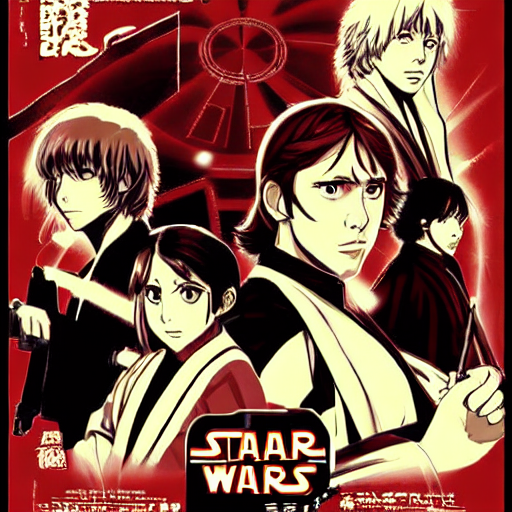

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a manga style movie poster of Star Wars'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

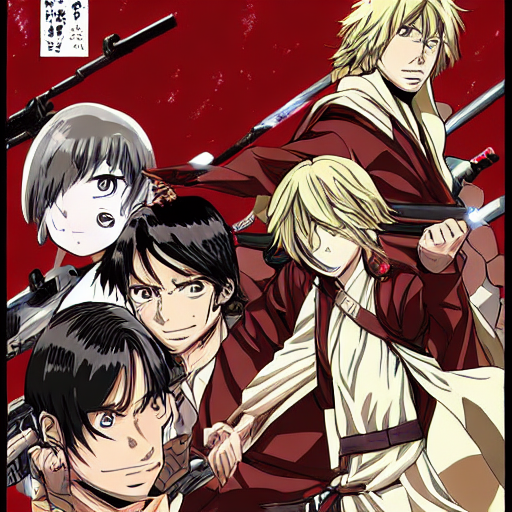

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a manga style movie poster of Star Wars'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

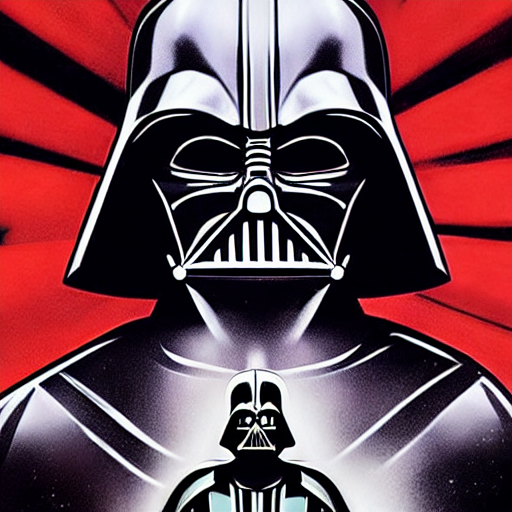

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

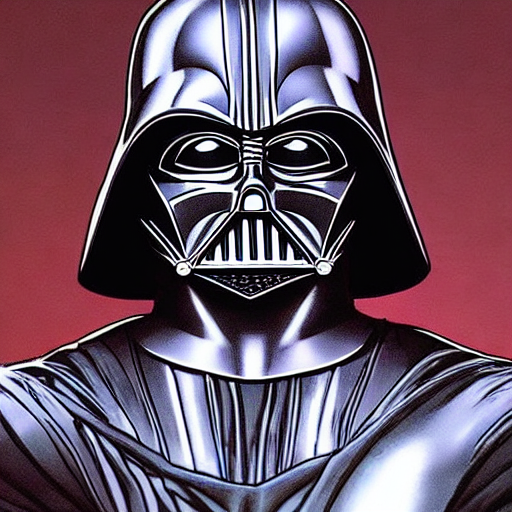

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of Star Wars with Darth Vader on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(2)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

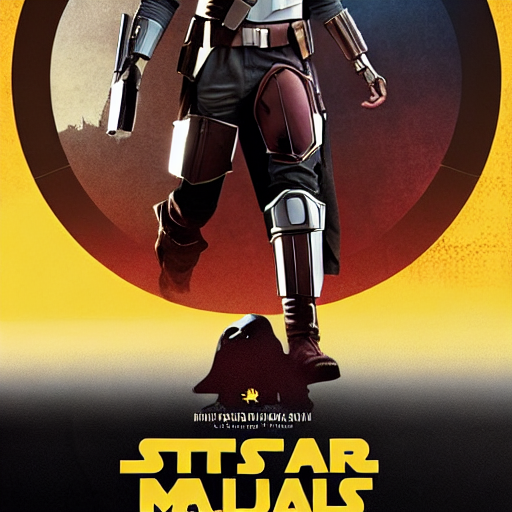

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of the mandalorian with grogu on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

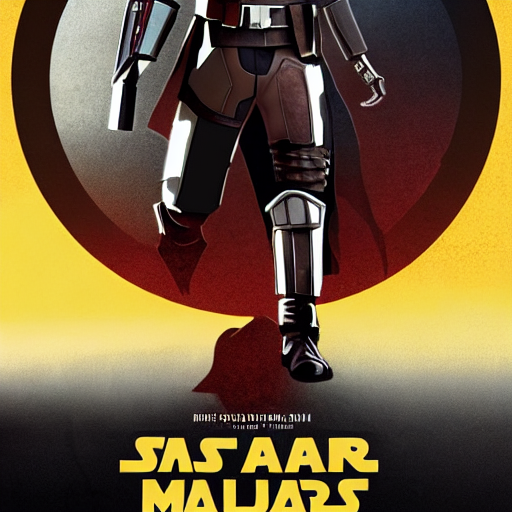

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of the mandalorian'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

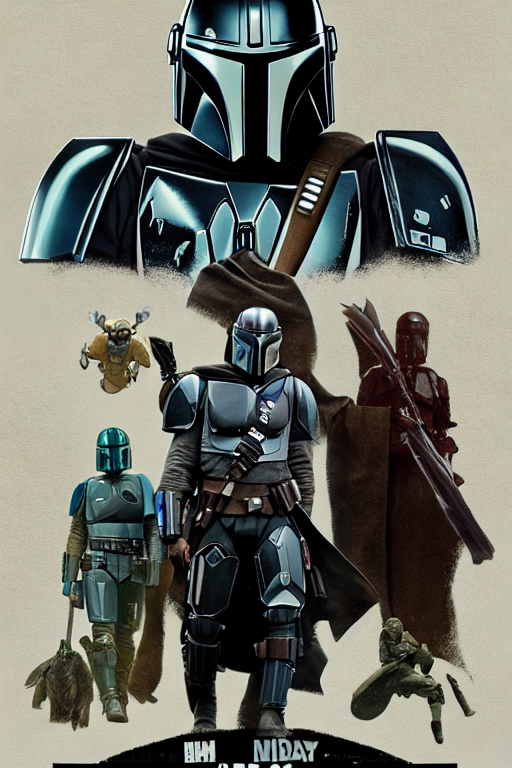

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of the mandalorian'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 768
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

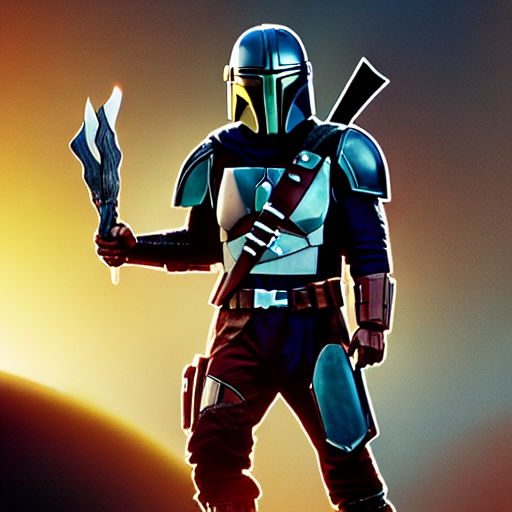

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a comic book style movie poster of the mandalorian'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

Interesting observation: it is easy to observer that the model is limited in termns of generalization. For instance, for Batman, the scenarions will be usully at night in rainy nights, so without specyfing that I want something in a rainy night, the model will automatically assume that, and if I try to force it to a sunny day, it won't work.

  0%|          | 0/50 [00:00<?, ?it/s]

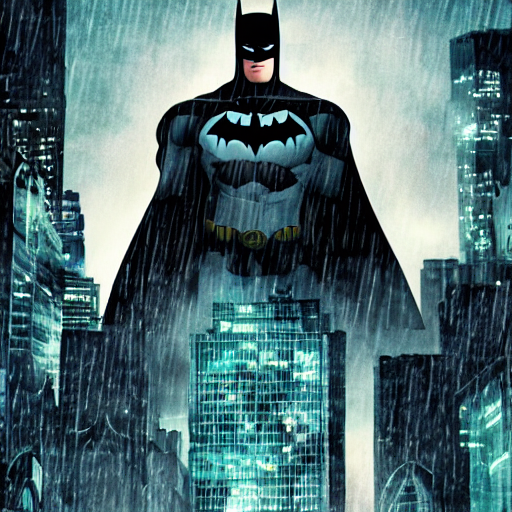

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'an animation movie poster of batman watching over gotham'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(7)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

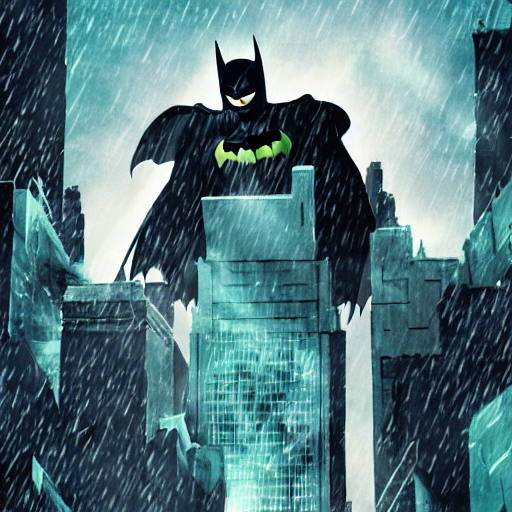

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'an animation movie poster of batman watching over gotham in a sunny day'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(7)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

### I think different scheduler

In [ ]:
pipe.scheduler

DPMSolverMultistepScheduler {
  "_class_name": "DPMSolverMultistepScheduler",
  "_diffusers_version": "0.11.1",
  "algorithm_type": "dpmsolver++",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "dynamic_thresholding_ratio": 0.995,
  "lower_order_final": true,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "solver_order": 2,
  "solver_type": "midpoint",
  "steps_offset": 1,
  "thresholding": false,
  "trained_betas": null
}

  0%|          | 0/50 [00:00<?, ?it/s]

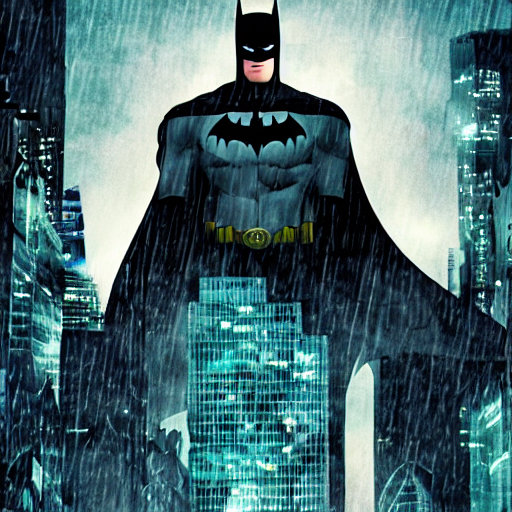

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'an animation movie poster of batman watching over gotham'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(7)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

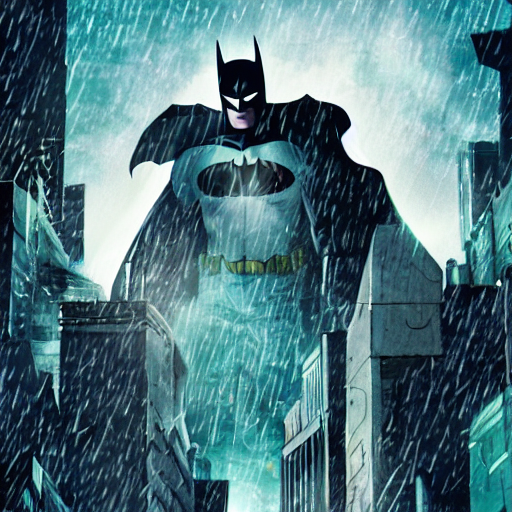

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'an animation movie poster of batman watching over gotham in a sunny day'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(7)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

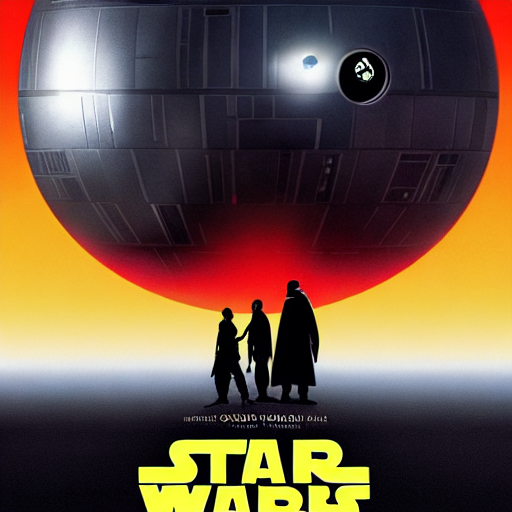

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style movie poster for star wars with Darth Vader and the Death Star on the cover'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

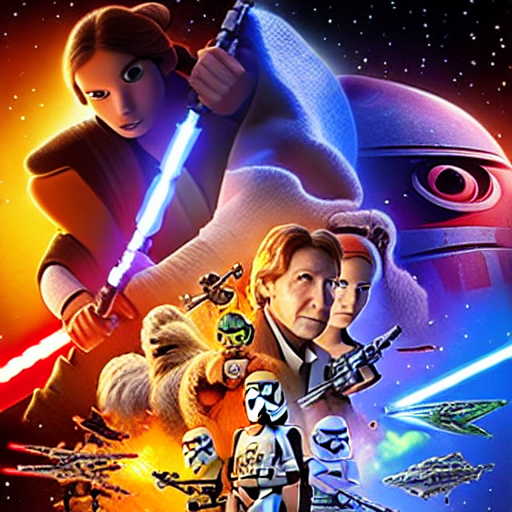

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style star wars movie poster'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

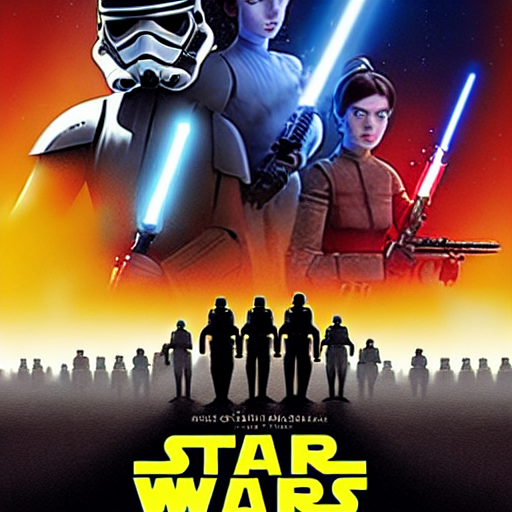

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style star wars movie poster with soldiers marching'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

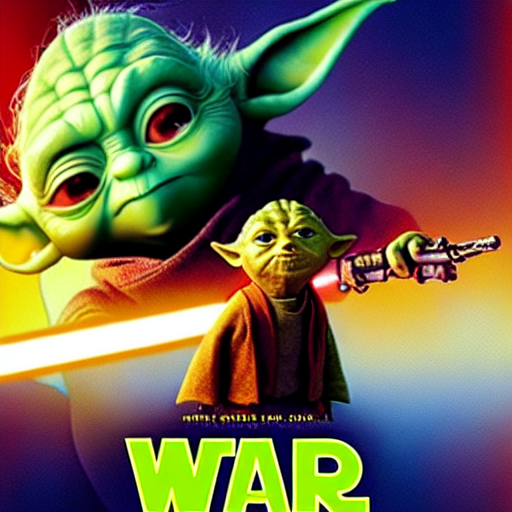

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style star wars movie poster with yoda on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

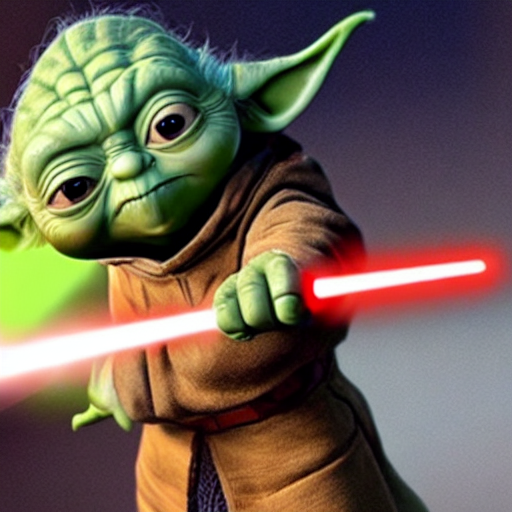

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a pixar style star wars movie poster with yoda on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

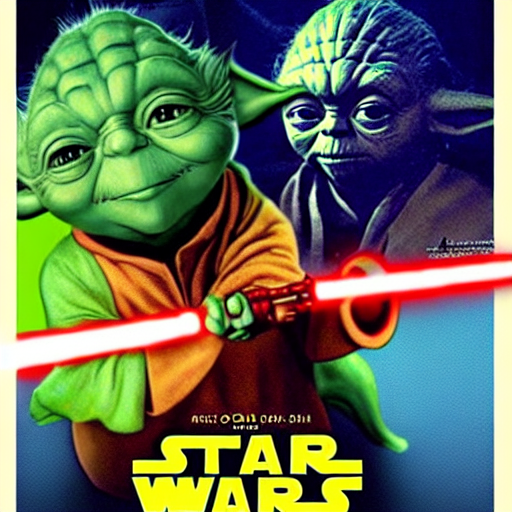

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'a disney style star wars movie poster with yoda on it'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(3)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             #negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

* Specifying the studio of the animation leads to better quality images in average.

  0%|          | 0/50 [00:00<?, ?it/s]

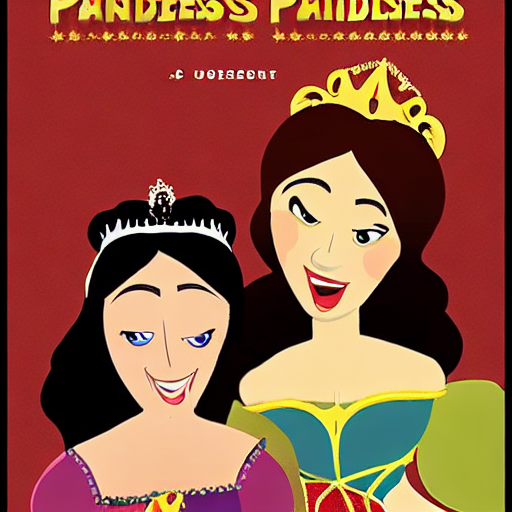

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

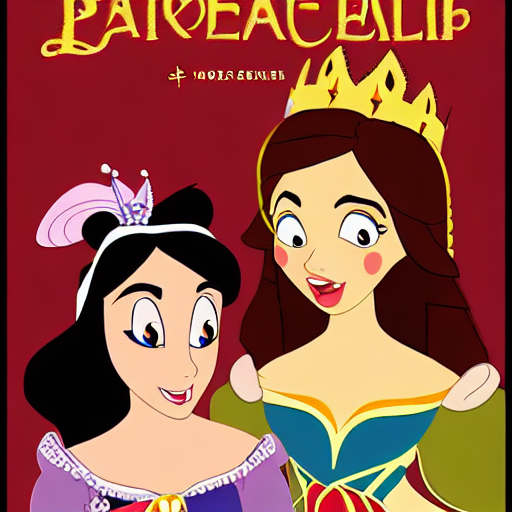

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses with disney style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

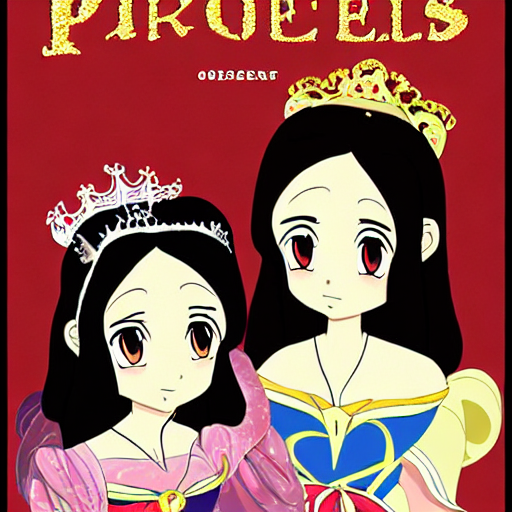

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses with manga style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

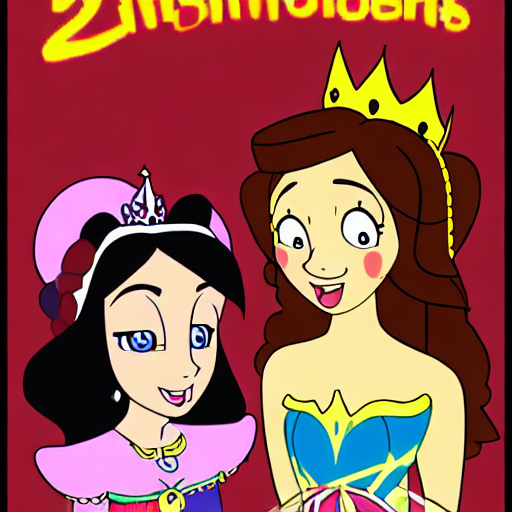

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses with nickelodeon style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

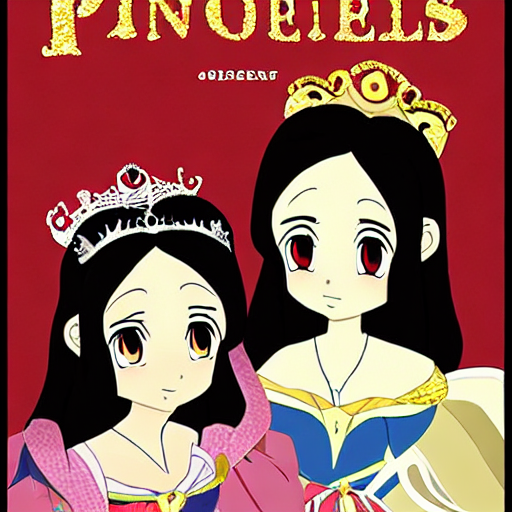

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for an animation about two princesses with manga style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 8
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

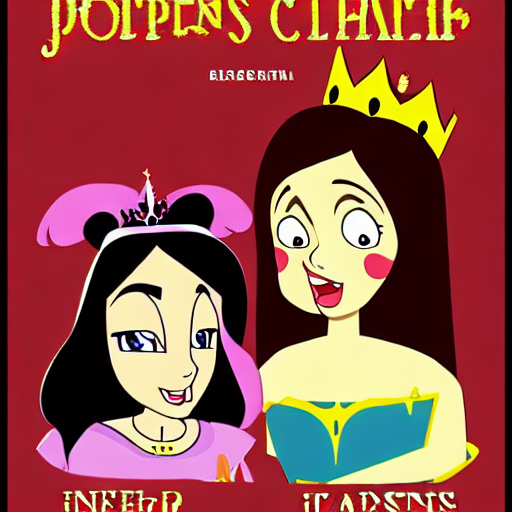

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses with cartoon network style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

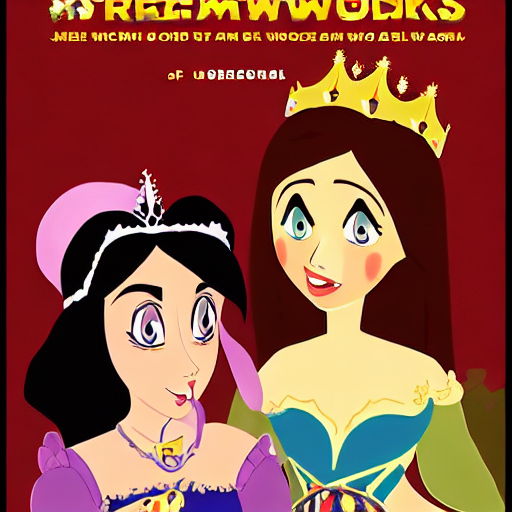

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for a animation about two princesses with DreamWorks Pictures style'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

* Test model ability to recognize characters (from sherek, is it able to draw the cat)?
* Negative prompts

  0%|          | 0/50 [00:00<?, ?it/s]

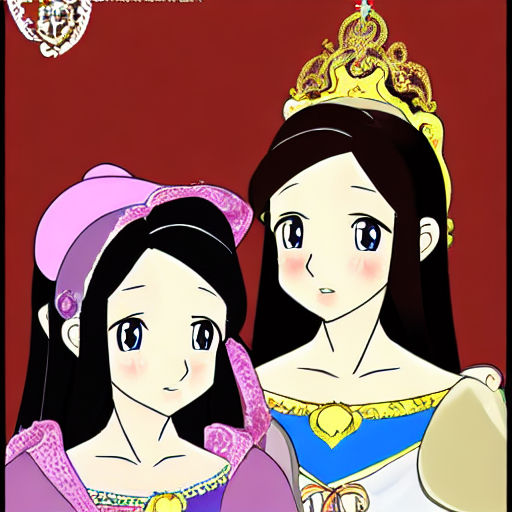

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for an animation about two princesses with manga style'
negative_prompt = 'text on the movie poster'
generator = torch.Generator(torch_device).manual_seed(1)
w = 8
num_inference_steps = 50
n_images = 1

height = 512
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

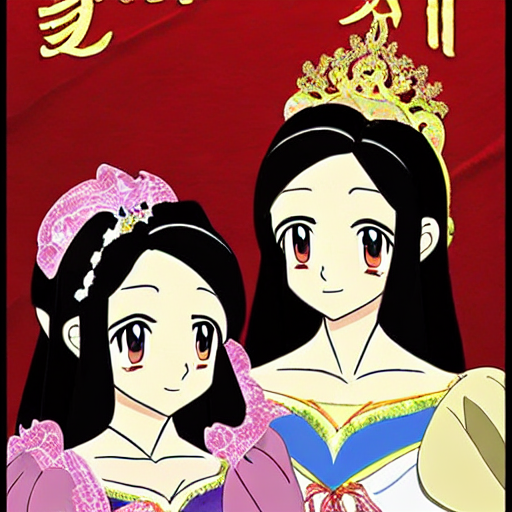

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for an animation about two princesses with manga style'
negative_prompt = 'text on the image'
generator = torch.Generator(torch_device).manual_seed(1)
w = 8
num_inference_steps = 50
n_images = 1

height = 768
width = 512

image = pipe(prompt,
             negative_prompt=negative_prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

In [ ]:
studios = ['Pixar', 'Universal Pictures', 'Nickelodeon', 'Cartoon Network', 'DreamWorks Pictures']

# Testing other versions of SF

In [ ]:
from diffusers import EulerDiscreteScheduler

model_id = "stabilityai/stable-diffusion-2"

# Use the Euler scheduler here instead
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler)
pipe = pipe.to("cuda")

prompt = "a photo of an astronaut riding a horse on mars"
image = pipe(prompt).images[0]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

# Random tests

In [ ]:
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
pipe = pipe.to(torch_device)
pipe.safety_checker = dummy
prompt = 'movie poster for batman'
generator = torch.Generator(torch_device).manual_seed(1)
w = 7.5 #The default is 7.5
num_inference_steps = 50
n_images = 1

height = 768
width = 512

  0%|          | 0/50 [00:00<?, ?it/s]

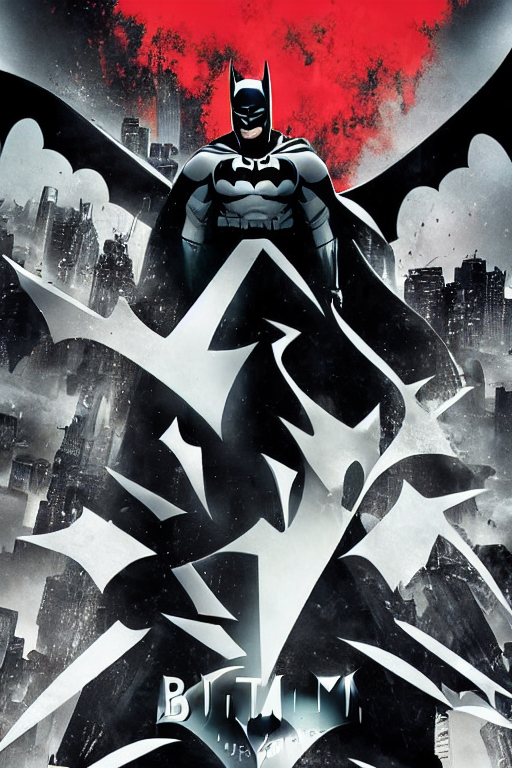

In [ ]:
image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

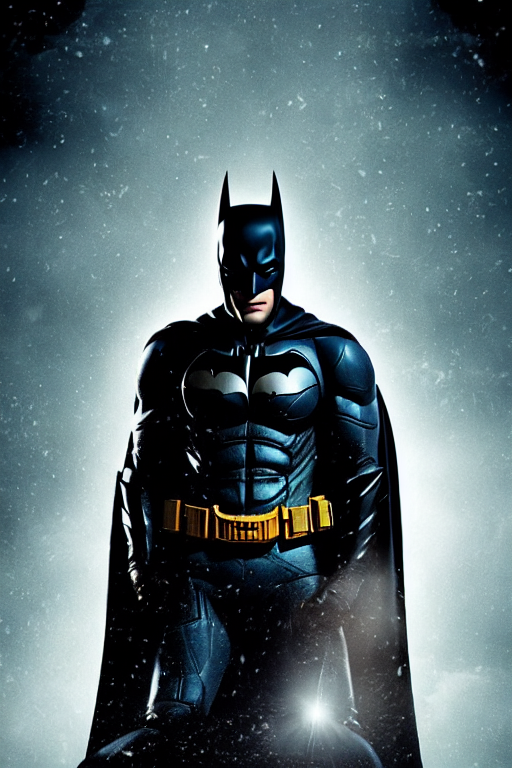

In [ ]:
image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

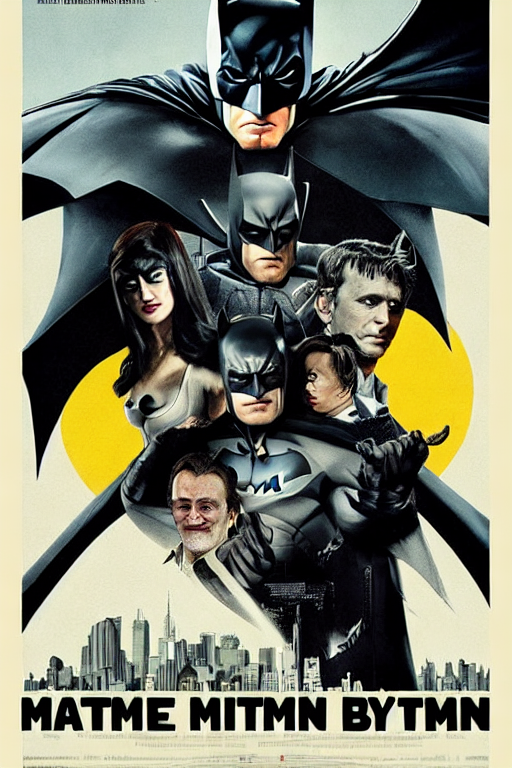

In [ ]:
image = pipe(prompt,
             generator=generator,
             guidance_scale=7.5,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image

  0%|          | 0/50 [00:00<?, ?it/s]

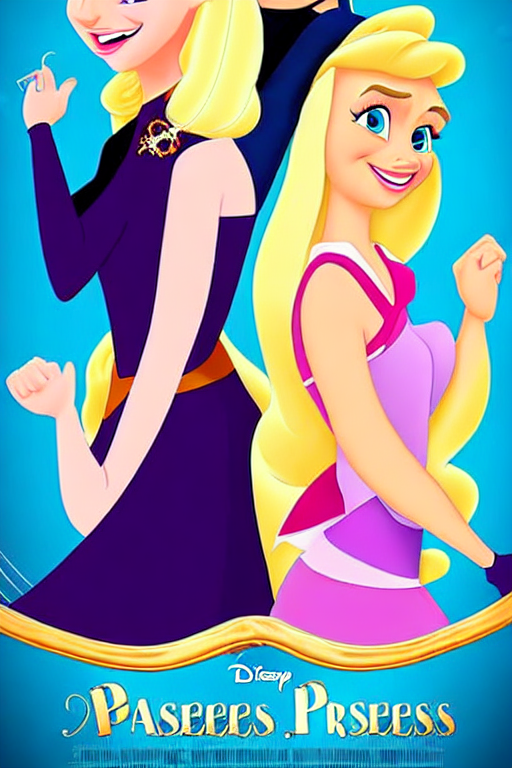

In [ ]:
prompt = 'A movie poster with two blonde princesses on the cover with Disney animation style'
image = pipe(prompt,
             generator=generator,
             guidance_scale=w,
             height=height,
             width=width,
             num_inference_steps=num_inference_steps,
             num_images_per_prompt=n_images).images[0]
image